In [1]:
!pip install arabica

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.9/40.9 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.2/45.2 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 523.1/523.1 kB 26.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 85.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.7/73.7 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 51.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 86.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 72.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 40.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 770.5/770.5 kB 36.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 7.9 MB/s eta 0:00:00
  Attempting uninstall: regex
    Found existing inst

In [2]:
path = "/kaggle/input/ai-companions-app-reviews/reviews.csv"

In [3]:
from arabica import *
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from gensim.utils import simple_preprocess
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
import re
import warnings

warnings.filterwarnings('ignore')
%matplotlib inline

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /usr/share/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [4]:
data = pd.read_csv(path)
data.drop('Unnamed: 0', axis=1, inplace=True)
data['date']  = pd.to_datetime(data['date'])

In [5]:
filtered_data = data[data['rev_length']>=10]

In [6]:
stopwords = stopwords.words('english')
addn_stopwords = ['app','really','snapchat', 'google', 'assistant','please','dark','mode','update','wrong','something',
                  'went','say','ever','android','ios']

addn_stopwords = ['app','really','snapchat', 'google', 'assistant','please','dark','mode','update','wrong','something',
                  'went','say','ever','android','ios','replika','chatgpt','gpt','snap','filter','also','ai']

In [7]:
filtered_data['review'] = filtered_data['review'].apply(lambda x: re.sub(r'[^\w\s]', '', x))
filtered_data['review'] = filtered_data['review'].apply(lambda x: x.lower())
filtered_data['review'] = filtered_data['review'].apply(lambda x: ' '.join(i for i in x.split(' ') if i not in stopwords+addn_stopwords))

In [8]:
positive_revs = filtered_data[filtered_data['feedback']=='positive']
negative_revs = filtered_data[filtered_data['feedback']=='negative']

after_21_revs = filtered_data[filtered_data['date']>'2021']
before_21_revs = filtered_data[filtered_data['date'] <= '2021']

In [9]:
#Descriptive Analysis

In [10]:
arabica_freq(text = filtered_data['review'],
             time = filtered_data['date'],
             date_format = 'us',
             time_freq = 'ungroup',
             max_words = 10,
             stopwords = ['english'],
             skip = [],           # Remove additional stop words
             numbers = True,
             lower_case = True)

,unigram,unigram_freq,bigram,bigram_freq,trigram,trigram_freq
0,like,45117,"dont,know",3954,"talking,real,person",734
1,good,32383,"doesnt,work",2903,"like,im,talking",486
2,dont,25026,"dont,like",2812,"like,talking,real",406
3,cant,23915,"cant,even",2363,"like,real,person",394
4,love,22484,"every,time",2328,"every,time,try",373
5,im,22371,"feel,like",2248,"samsung,galaxy,s",346
6,get,21044,"would,like",1974,"feel,like,im",340
7,use,20558,"dont,want",1960,"bring,back,old",328
8,even,20516,"even,though",1856,"keep,good,work",317
9,great,19419,"wont,let",1844,"every,time,open",301


In [11]:
arabica_freq(text = positive_revs['review'],
             time = positive_revs['date'],
             date_format = 'us',
             time_freq = 'ungroup',
             max_words = 10,
             stopwords = ['english'],
             skip = [],           # Remove additional stop words
             numbers = True,
             lower_case = True)

,unigram,unigram_freq,bigram,bigram_freq,trigram,trigram_freq
0,like,24693,"real,person",1438,"talking,real,person",658
1,good,20496,"feel,like",1425,"like,im,talking",377
2,love,17233,"dont,know",1367,"like,talking,real",356
3,great,13456,"dont,like",1197,"like,real,person",337
4,friends,10011,"would,like",1185,"keep,good,work",298
5,im,9742,"feels,like",1039,"feel,like,im",252
6,would,9711,"pretty,good",972,"im,talking,real",240
7,dont,8920,"talk,friends",971,"thing,dont,like",226
8,use,8823,"friends,family",962,"feels,like,im",212
9,amazing,8327,"easy,use",917,"need,someone,talk",188


In [12]:
arabica_freq(text = negative_revs['review'],
             time = negative_revs['date'],
             date_format = 'us',
             time_freq = 'ungroup',
             max_words = 10,
             stopwords = ['english'],
             skip = [],           # Remove additional stop words
             numbers = True,
             lower_case = True)

,unigram,unigram_freq,bigram,bigram_freq,trigram,trigram_freq
0,like,20424,"dont,know",2587,"every,time,try",327
1,cant,17728,"doesnt,work",2420,"bring,back,old",298
2,dont,16106,"cant,even",2157,"samsung,galaxy,s",278
3,even,14625,"every,time",1900,"every,time,open",264
4,get,12962,"dont,like",1615,"still,doesnt,work",228
5,phone,12884,"wont,let",1444,"dont,know,whats",197
6,im,12629,"dont,want",1438,"ive,tried,everything",183
7,good,11887,"even,though",1274,"cant,get,rid",183
8,fix,11829,"get,rid",1101,"got,new,phone",173
9,use,11735,"stopped,working",975,"front,facing,camera",162


In [13]:
#WordCloud form TriGrams

<Figure size 1000x600 with 0 Axes>

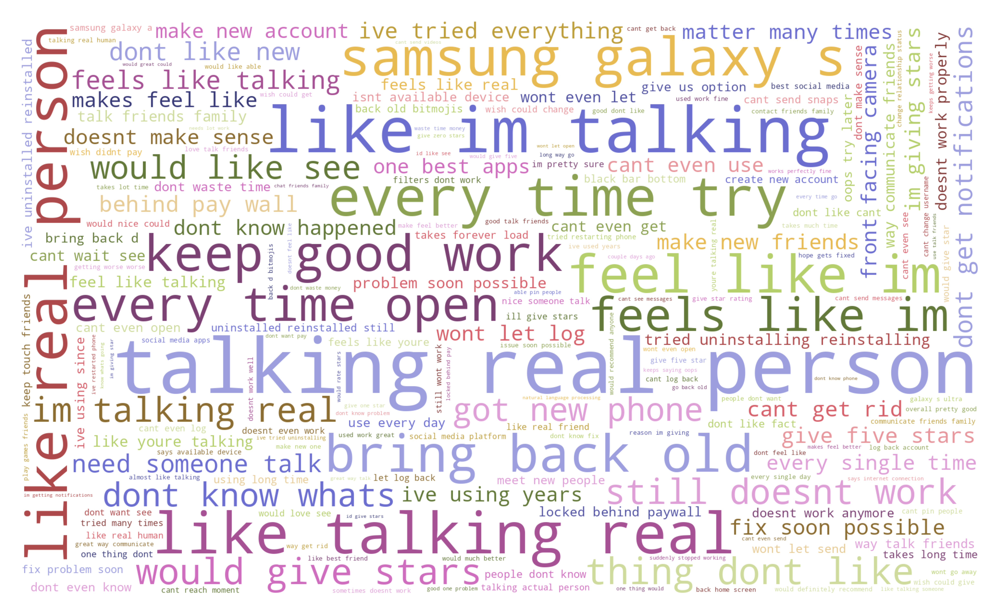

In [14]:
cappuccino(text = filtered_data['review'],
           time = filtered_data['date'],
           date_format = 'us',
           plot = 'wordcloud',
           ngram = 3,
           time_freq = 'ungroup',
           max_words = 500,
           stopwords = ['english'],
           skip = [], # Remove additional stop words
           numbers = True,
           lower_case = True)

<Figure size 1000x600 with 0 Axes>

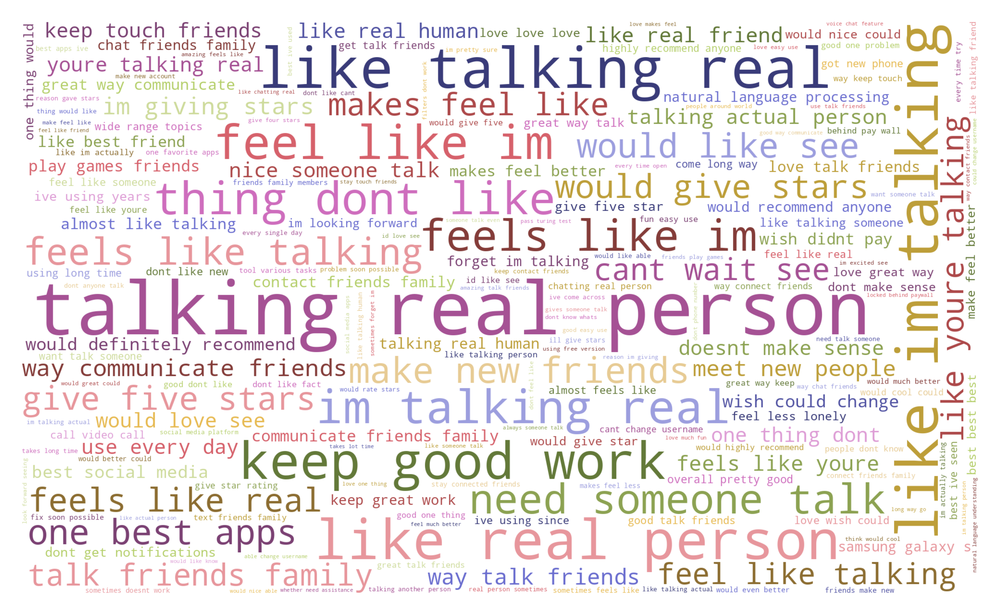

In [15]:
cappuccino(text = positive_revs['review'],
           time = positive_revs['date'],
           date_format = 'us',
           plot = 'wordcloud',
           ngram = 3,
           time_freq = 'ungroup',
           max_words = 500,
           stopwords = ['english'],
           skip = [], # Remove additional stop words
           numbers = True,
           lower_case = True)

<Figure size 1000x600 with 0 Axes>

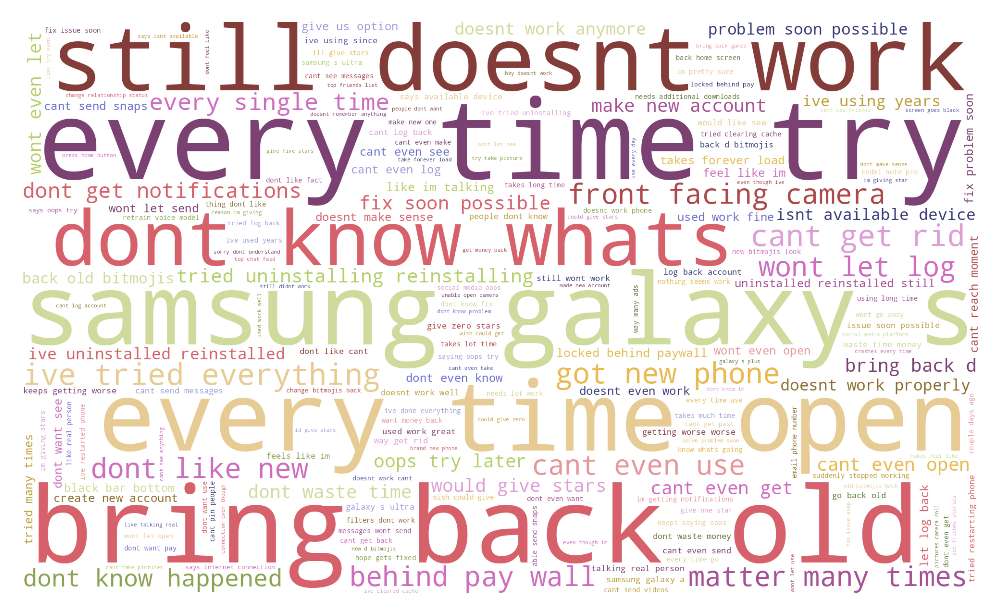

In [16]:
cappuccino(text = negative_revs['review'],
           time = negative_revs['date'],
           date_format = 'us',
           plot = 'wordcloud',
           ngram = 3,
           time_freq = 'ungroup',
           max_words = 500,
           stopwords = ['english'],
           skip = [], # Remove additional stop words
           numbers = True,
           lower_case = True)

In [17]:
cappuccino(text = positive_revs['review'][:100],
           time = positive_revs['date'][:100],
           date_format = 'us',
           plot = 'line',
           ngram = 3,
           time_freq = 'Y',
           max_words = 6,
           stopwords = ['english'],
           skip = [],
           numbers = True,
           lower_case = True
)

SystemExit: Incorrect value for time_freq parameter. Allowed: "ungroup"

In [ ]:
cappuccino(text = negative_revs['review'],
          time = negative_revs['date'],
          date_format = 'us',
          plot = 'line',
          ngram = 2,
          time_freq = 'Y',
          max_words = 6,
          stopwords = ['english'],
          skip = [],
          numbers = True,
          lower_case = True)

In [ ]:
# Data visualization module

from plotnine import *
from arabica import arabica_freq
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import pandas as pd
import numpy as np
import sys



def cappuccino(text: str,                  # Text
               time: str,                  # Time
               date_format: str,           # Date format: 'eur' - European, 'us' - American
               stopwords: [],              # Languages for stop words
               skip: [ ],                  # Remove additional strings
               plot: str = '',             # Chart type: 'wordcloud'/'heatmap'/'line'
               ngram: int = '',            # N-gram size, 1 = unigram, 2 = bigram, 3 = trigram
               time_freq: str = '',        # Aggregation period: 'Y'/'M', if no aggregation: 'ungroup'
               max_words: int = '',        # Max number for most frequent n-grams displayed for each period
               numbers: bool = False,      # Remove numbers
               lower_case: bool = False):  # Lowercase text before cleaning and frequency analysis

    result = arabica_freq(text = text,
                          time = time,
                          date_format = date_format,
                          time_freq = time_freq,
                          max_words = max_words,
                          stopwords = stopwords,
                          skip = skip,
                          numbers = numbers,
                          lower_case = lower_case)

    if ngram == 1:
        if time_freq == 'ungroup':
            if plot == 'wordcloud':
                unigrams_df = result[['unigram','unigram_freq']]
                unigrams_df = unigrams_df.dropna()
                unigrams_df['unigram_freq'] = unigrams_df['unigram_freq'].astype(int)
                unigrams_dict = dict(unigrams_df.values)
                fig = figure()
                wordcloud_unigram = WordCloud(background_color="white",
                                              colormap='tab20b',
                                              max_font_size=250,
                                              width=2000,
                                              height=1200,
                                              margin=10).generate_from_frequencies(unigrams_dict)
                plt.figure(dpi=1200)
                plt.imshow(wordcloud_unigram,interpolation="bilinear")
                fig.set_size_inches(10, 6, forward=True)
                plt.axis('off')
                picture = plt.show()

            else:
                sys.exit('Incorrect value for plot parameter. Allowed: "wordcloud"')


        elif time_freq == 'M':
            period = result['period']
            subset = result['unigram']
            subset = subset.dropna()
            subset_expand = subset.str.split(pat=",", expand=True)
            subset_expand.columns = ['unigram' + str(i + 1) for i in range(len(subset_expand.columns))]
            subset_expand["id"] = subset_expand.index
            test = subset_expand.merge(period, left_index = True, right_index = True)
            reshaped = pd.wide_to_long(test, ['unigram'], i="id", j="period")
            period_re = reshaped['period']
            period_re.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped['unigram']
            reshaped_unigram.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped_unigram.str.split(pat=": ", expand=True)
            reshaped_unigram = reshaped_unigram.rename(columns={0: 'unigram', 1: 'frequency'})
            reshaped_unigram = reshaped_unigram.dropna()
            reshaped_unigram['frequency'] = reshaped_unigram['frequency'].astype(int)
            reshaped_unigram = reshaped_unigram.merge(period_re, left_index = True, right_index = True)

            if plot == 'heatmap':
                reshaped_unigram = reshaped['unigram']
                reshaped_unigram.reset_index(drop=True, inplace=True)
                reshaped_unigram = reshaped_unigram.str.split(pat=": ", expand=True)
                reshaped_unigram = reshaped_unigram.rename(columns={0: 'unigram', 1: 'frequency'})
                reshaped_unigram = reshaped_unigram.dropna()
                reshaped_unigram['frequency'] = reshaped_unigram['frequency'].astype(int)
                reshaped_unigram = reshaped_unigram.merge(period_re, left_index = True, right_index = True)
                reshaped_unigram_max = reshaped_unigram.groupby(['unigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram = reshaped_unigram.merge(reshaped_unigram_max, on = ['unigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram['label'] = np.where(reshaped_unigram['_merge']=='both', reshaped_unigram['unigram'], '')
                reshaped_unigram = reshaped_unigram[['unigram', 'frequency', 'period','label']]

                fig = (ggplot(reshaped_unigram, aes('period', 'unigram', fill='frequency'))
                       + geom_tile(aes(width=1, height=1))
                       + geom_text(aes(label='frequency'), size=10)
                       + theme_minimal()
                       + scale_fill_gradient(name = "frequency",
                                             low = "#f0f4ed",
                                             high = "#496160")
                       + theme(axis_title_x=element_text(colour = "black"),
                               axis_title_y=element_text(colour="black"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust= 1),
                               legend_text = element_text(size = 7),
                               legend_title = element_text(color = "black", vjust= -1.3, size = 10),
                               figure_size= (3 + ((len(period) /4)), (3 + (max_words * 1.5))),
                               panel_grid_major = element_line(color='black',size = 0.1),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       ).draw(show=False, return_ggplot=True)

                plt.gcf().set_dpi(800)
                picture = plt.show()


            elif plot == 'line':
                reshaped_unigram_wide = pd.pivot(reshaped_unigram, index = 'unigram', columns = 'period', values = 'frequency')
                reshaped_unigram_wide = reshaped_unigram_wide.fillna(0)
                year_list=list(reshaped_unigram_wide.columns)
                reshaped_unigram_wide = pd.melt(reshaped_unigram_wide, value_vars=year_list,value_name='frequency', ignore_index=False)
                reshaped_unigram_wide = reshaped_unigram_wide.reset_index()
                reshaped_unigram_max = reshaped_unigram_wide.groupby(['unigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram_wide = reshaped_unigram_wide.merge(reshaped_unigram_max, on = ['unigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram_wide['label'] = np.where(reshaped_unigram_wide['_merge']=='both', reshaped_unigram_wide['unigram'], '')
                reshaped_unigram_wide = reshaped_unigram_wide[['unigram', 'frequency', 'period','label']]

                fig = (ggplot(reshaped_unigram_wide)
                       + geom_point(aes(x = 'period', y = 'frequency',color = 'unigram'))
                       + geom_line(aes(x = 'period', y = 'frequency', color = 'unigram',group='unigram'))
                       + geom_label(aes(x = 'period', y = 'frequency', label = 'label',size = 1), nudge_y=2)
                       + scale_size_continuous(guide = None)
                       + guides(color=guide_legend(nrow=40))
                       + theme_minimal()
                       + theme(axis_title_x=element_text(colour = "black",size = 7),
                               axis_title_y=element_text(colour="black", size = 7),
                               axis_title=element_text(face="bold"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust=1, size = 7),
                               legend_text = element_text(size=7),
                               legend_title = element_text(size=10),
                               legend_key_height = 0.5,
                               legend_key_width = 0.5,
                               figure_size=(10, 5),
                               panel_grid_major = element_blank(),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       ).draw(show=False, return_ggplot=True)


                plt.gcf().set_dpi(800)
                picture = plt.show()

            else:
                sys.exit('Incorrect value for plot parameter. Allowed: "heatmap", "line"')


        elif time_freq == 'Y':
            period = result['period']
            subset = result['unigram']
            subset = subset.dropna()
            subset_expand = subset.str.split(pat=",", expand=True)
            subset_expand.columns = ['unigram' + str(i + 1) for i in range(len(subset_expand.columns))]
            subset_expand["id"] = subset_expand.index
            test = subset_expand.merge(period, left_index = True, right_index = True)
            reshaped = pd.wide_to_long(test, ['unigram'], i="id", j="period")
            period_re = reshaped['period']
            period_re.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped['unigram']
            reshaped_unigram.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped_unigram.str.split(pat=": ", expand=True)
            reshaped_unigram = reshaped_unigram.rename(columns={0: 'unigram', 1: 'frequency'})
            reshaped_unigram = reshaped_unigram.dropna()
            reshaped_unigram['frequency'] = reshaped_unigram['frequency'].astype(int)
            reshaped_unigram = reshaped_unigram.merge(period_re, left_index = True, right_index = True)

            if plot == 'heatmap':
                reshaped_unigram = reshaped['unigram']
                reshaped_unigram.reset_index(drop=True, inplace=True)
                reshaped_unigram = reshaped_unigram.str.split(pat=": ", expand=True)
                reshaped_unigram = reshaped_unigram.rename(columns={0: 'unigram', 1: 'frequency'})
                reshaped_unigram = reshaped_unigram.dropna()
                reshaped_unigram['frequency'] = reshaped_unigram['frequency'].astype(int)
                reshaped_unigram = reshaped_unigram.merge(period_re, left_index = True, right_index = True)
                reshaped_unigram_max = reshaped_unigram.groupby(['unigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram = reshaped_unigram.merge(reshaped_unigram_max, on = ['unigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram['label'] = np.where(reshaped_unigram['_merge']=='both', reshaped_unigram['unigram'], '')
                reshaped_unigram = reshaped_unigram[['unigram', 'frequency', 'period','label']]

                fig = (ggplot(reshaped_unigram, aes('period', 'unigram', fill='frequency'))
                       + geom_tile(aes(width=0.95, height=0.95))
                       + geom_text(aes(label='frequency'), size=7)
                       + theme_minimal()
                       + theme(axis_title_x=element_text(colour = "black"),
                               axis_title_y=element_text(colour="black"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust= 1),
                               legend_text = element_text(size = 7),
                               legend_title = element_text(color = "black", size = 10),
                               figure_size= (3 + ((len(period) /4)), (2 + (max_words * 0.5))),
                               panel_grid_major = element_line(color='black',size = 0.1),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       + scale_fill_gradient(name = "frequency",
                                             low = "#f0f4ed",
                                             high = "#496160")
                       ).draw(show=False, return_ggplot=True)

                plt.gcf().set_dpi(800)
                picture = plt.show()

            elif plot == 'line':
                reshaped_unigram_wide = pd.pivot(reshaped_unigram, index = 'unigram', columns = 'period', values = 'frequency')
                reshaped_unigram_wide = reshaped_unigram_wide.fillna(0)
                year_list=list(reshaped_unigram_wide.columns)
                reshaped_unigram_wide = pd.melt(reshaped_unigram_wide, value_vars=year_list,value_name='frequency', ignore_index=False)
                reshaped_unigram_wide = reshaped_unigram_wide.reset_index()
                reshaped_unigram_max = reshaped_unigram_wide.groupby(['unigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram_wide = reshaped_unigram_wide.merge(reshaped_unigram_max, on = ['unigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram_wide['label'] = np.where(reshaped_unigram_wide['_merge']=='both', reshaped_unigram_wide['unigram'], '')
                reshaped_unigram_wide = reshaped_unigram_wide[['unigram', 'frequency', 'period','label']]

                fig = (ggplot(reshaped_unigram_wide)
                       + geom_point(aes(x = 'period', y = 'frequency',color = 'unigram'))
                       + geom_line(aes(x = 'period', y = 'frequency', color = 'unigram',group='unigram'))
                       + geom_label(aes(x = 'period', y = 'frequency', label = 'label',size = 0.2), nudge_y=0.3)
                       + scale_size_continuous(guide = None)
                       + guides(color=guide_legend(nrow=40))
                       + theme_minimal()
                       + theme(axis_title_x=element_text(colour = "black",size = 7),
                               axis_title_y=element_text(colour="black", size = 7),
                               axis_title=element_text(face="bold"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust=1, size = 7),
                               legend_text = element_text(size=7),
                               legend_title = element_text(size=10),
                               legend_key_height = 0.5,
                               legend_key_width = 0.5,
                               figure_size=(5 + max_words, (1 + (max_words * 1.0))),
                               panel_grid_major = element_blank(),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       ).draw(show=False, return_ggplot=True)


                plt.gcf().set_dpi(800)
                picture = plt.show()

            else:
                sys.exit('Incorrect value for plot parameter. Allowed: "heatmap", "line"')

        else:
            sys.exit('Incorrect value for time_freq parameter. Allowed: "ungroup", "Y", "M"')

    elif ngram == 2:
        if time_freq == 'ungroup':
            if plot == 'wordcloud':
                bigram_df = result[['bigram','bigram_freq']]
                bigram_df = bigram_df.dropna()
                bigram_df['bigram'] = bigram_df['bigram'].str.replace(",", " ")
                bigram_df['bigram_freq'] = bigram_df['bigram_freq'].astype(int)
                bigrams_dict = dict(bigram_df.values)
                fig = figure()
                wordcloud_bigram = WordCloud(background_color="white",
                                             colormap='tab20b',
                                             width=2000,
                                             height=1200,
                                             margin=10
                                             ).generate_from_frequencies(bigrams_dict)
                plt.figure(dpi=1200)
                plt.imshow(wordcloud_bigram,interpolation="bilinear")
                fig.set_size_inches(10, 6, forward=True)
                plt.axis('off')
                picture = plt.show()

            else:
                sys.exit('Incorrect value for plot parameter. Allowed: "wordcloud"')

        elif time_freq == 'M':
            period = result['period']
            subset = result['bigram']
            subset = subset.dropna()
            subset_expand = subset.str.split(pat=",", expand=True)

            cols = (' '.join(w) for w in zip(subset_expand.columns[::2].astype(str), subset_expand.columns[1::2].astype(str)))
            subset_expand_adj = pd.DataFrame(subset_expand.iloc[:, ::2].astype(str).values +
                                             ' ' + subset_expand.iloc[:, 1::2].astype(str).values +
                                             ' ', index=subset_expand.index, columns=cols)

            subset_expand_adj.columns = ['bigram' + str(i + 1) for i in range(len(subset_expand_adj.columns))]
            subset_expand_adj["id"] = subset_expand_adj.index
            test = subset_expand_adj.merge(period, left_index = True, right_index = True)
            reshaped = pd.wide_to_long(test, ['bigram'], i="id", j="period")
            period_re = reshaped['period']
            period_re.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped['bigram']
            reshaped_unigram.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped_unigram.str.split(pat=": ", expand=True)
            reshaped_unigram = reshaped_unigram.rename(columns={0: 'bigram', 1: 'frequency'})
            reshaped_unigram = reshaped_unigram.dropna()
            reshaped_unigram['frequency'] = reshaped_unigram['frequency'].astype(int)
            reshaped_unigram = reshaped_unigram.merge(period_re, left_index = True, right_index = True)

            if plot == 'heatmap':
                reshaped_unigram_max = reshaped_unigram.groupby(['bigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram = reshaped_unigram.merge(reshaped_unigram_max, on = ['bigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram['label'] = np.where(reshaped_unigram['_merge']=='both', reshaped_unigram['bigram'], '')
                reshaped_unigram = reshaped_unigram[['bigram', 'frequency', 'period','label']]

                fig = (ggplot(reshaped_unigram, aes('period', 'bigram', fill='frequency'))
                       + geom_tile(aes(width=.95, height=.95))
                       + geom_text(aes(label='frequency'), size=10)
                       + theme_minimal()
                       + scale_fill_gradient(name = "frequency",
                                             low = "#f0f4ed",
                                             high = "#496160")
                       + theme(axis_title_x=element_text(colour = "black"),
                               axis_title_y=element_text(colour="black"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust= 1),
                               legend_text = element_text(size = 5,vjust = 0.2),
                               legend_title = element_text(color = "black", vjust = 0.8, size = 10),
                               figure_size= (3 + ((len(period) /4)), (2 + (max_words * 2.2))),
                               panel_grid_major = element_line(color='black',size = 0.1),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       ).draw(show=False, return_ggplot=True)


                plt.gcf().set_dpi(800)
                picture = plt.show()


            elif plot == 'line':
                reshaped_unigram_wide = pd.pivot(reshaped_unigram, index = 'bigram', columns = 'period', values = 'frequency')
                reshaped_unigram_wide = reshaped_unigram_wide.fillna(0)
                year_list=list(reshaped_unigram_wide.columns)
                reshaped_unigram_wide = pd.melt(reshaped_unigram_wide, value_vars=year_list,value_name='frequency', ignore_index=False)
                reshaped_unigram_wide = reshaped_unigram_wide.reset_index()
                reshaped_unigram_max = reshaped_unigram_wide.groupby(['bigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram_wide = reshaped_unigram_wide.merge(reshaped_unigram_max, on = ['bigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram_wide['label'] = np.where(reshaped_unigram_wide['_merge']=='both', reshaped_unigram_wide['bigram'], '')
                reshaped_unigram_wide = reshaped_unigram_wide[['bigram', 'frequency', 'period','label']]


                fig = (ggplot(reshaped_unigram_wide)
                       + geom_point(aes(x = 'period', y = 'frequency',color = 'bigram'))
                       + geom_line(aes(x = 'period', y = 'frequency', color = 'bigram',group='bigram'))
                       + geom_label(aes(x = 'period', y = 'frequency', label = 'label',size = 0.2), nudge_y=0.3)
                       + scale_size_continuous(guide = None)
                       + guides(color=guide_legend(nrow=40))
                       + theme_minimal()
                       + theme(axis_title_x=element_text(colour = "black",size = 7),
                               axis_title_y=element_text(colour="black", size = 7),
                               axis_title=element_text(face="bold"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust=1, size = 7),
                               legend_text = element_text(size=7),
                               legend_title = element_text(size=10),
                               legend_key_height = 0.5,
                               legend_key_width = 0.5,
                               figure_size=(10, 5),
                               panel_grid_major = element_blank(),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       ).draw(show=False, return_ggplot=True)

                plt.gcf().set_dpi(800)
                picture = plt.show()

            else:
                sys.exit('Incorrect value for plot parameter. Allowed: "heatmap", "line"')


        elif time_freq == 'Y':
            period = result['period']
            subset = result['bigram']
            subset = subset.dropna()
            subset_expand = subset.str.split(pat=",", expand=True)

            cols = (' '.join(w) for w in zip(subset_expand.columns[::2].astype(str), subset_expand.columns[1::2].astype(str)))
            subset_expand_adj = pd.DataFrame(subset_expand.iloc[:, ::2].astype(str).values +
                                             ' ' + subset_expand.iloc[:, 1::2].astype(str).values +
                                             ' ', index=subset_expand.index, columns=cols)

            subset_expand_adj.columns = ['bigram' + str(i + 1) for i in range(len(subset_expand_adj.columns))]
            subset_expand_adj["id"] = subset_expand_adj.index
            test = subset_expand_adj.merge(period, left_index = True, right_index = True)
            reshaped = pd.wide_to_long(test, ['bigram'], i="id", j="period")
            period_re = reshaped['period']
            period_re.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped['bigram']
            reshaped_unigram.reset_index(drop=True, inplace=True)
            reshaped_unigram = reshaped_unigram.str.split(pat=": ", expand=True)
            reshaped_unigram = reshaped_unigram.rename(columns={0: 'bigram', 1: 'frequency'})
            reshaped_unigram = reshaped_unigram.dropna()
            reshaped_unigram['frequency'] = reshaped_unigram['frequency'].astype(int)
            reshaped_unigram = reshaped_unigram.merge(period_re, left_index = True, right_index = True)

            if plot == 'heatmap':
                reshaped_unigram_max = reshaped_unigram.groupby(['bigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram = reshaped_unigram.merge(reshaped_unigram_max, on = ['bigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram['label'] = np.where(reshaped_unigram['_merge']=='both', reshaped_unigram['bigram'], '')
                reshaped_unigram = reshaped_unigram[['bigram', 'frequency', 'period','label']]

                fig = (ggplot(reshaped_unigram, aes('period', 'bigram', fill='frequency'))
                       + geom_tile(aes(width=.95, height=.95))
                       + geom_text(aes(label='frequency'), size=10)
                       + theme_minimal()
                       + theme(axis_title_x=element_text(colour = "black"),
                               axis_title_y=element_text(colour="black"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust= 1),
                               legend_text = element_text(size = 5,vjust = 0.2),
                               legend_title = element_text(color = "black", vjust = 0.8, size = 10),
                               figure_size= (3 + ((len(period) /4)), (2 + (max_words * 1.7))),
                               panel_grid_major = element_line(color='black',size = 0.1),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       + scale_fill_gradient(name = "frequency",
                                             low = "#f0f4ed",
                                             high = "#496160")
                       ).draw(show=False, return_ggplot=True)

                plt.gcf().set_dpi(800)
                picture = plt.show()


            elif plot == 'line':
                reshaped_unigram_wide = pd.pivot(reshaped_unigram, index = 'bigram', columns = 'period', values = 'frequency')
                reshaped_unigram_wide = reshaped_unigram_wide.fillna(0)
                year_list=list(reshaped_unigram_wide.columns)
                reshaped_unigram_wide = pd.melt(reshaped_unigram_wide, value_vars=year_list,value_name='frequency', ignore_index=False)
                reshaped_unigram_wide = reshaped_unigram_wide.reset_index()
                reshaped_unigram_max = reshaped_unigram_wide.groupby(['bigram'], sort=False)['frequency'].max()
                reshaped_unigram_max = reshaped_unigram_max.reset_index()
                reshaped_unigram_wide = reshaped_unigram_wide.merge(reshaped_unigram_max, on = ['bigram','frequency'], how = 'left', indicator=True)
                reshaped_unigram_wide['label'] = np.where(reshaped_unigram_wide['_merge']=='both', reshaped_unigram_wide['bigram'], '')
                reshaped_unigram_wide = reshaped_unigram_wide[['bigram', 'frequency', 'period','label']]


                fig = (ggplot(reshaped_unigram_wide)
                       + geom_point(aes(x = 'period', y = 'frequency',color = 'bigram'))
                       + geom_line(aes(x = 'period', y = 'frequency', color = 'bigram',group='bigram'))
                       + geom_label(aes(x = 'period', y = 'frequency', label = 'label',size = 0.2), nudge_y=0.3)
                       + scale_size_continuous(guide = None)
                       + guides(color=guide_legend(nrow=40))
                       + theme_minimal()
                       + theme(axis_title_x=element_text(colour = "black",size = 7),
                               axis_title_y=element_text(colour="black", size = 7),
                               axis_title=element_text(face="bold"),
                               axis_text_x=element_text(colour = "black", rotation=45, hjust=1, size = 7),
                               legend_text = element_text(size=7),
                               legend_title = element_text(size=10),
                               legend_key_height = 0.5,
                               legend_key_width = 0.5,
                               figure_size=(5 + max_words, (1 + (max_words * 1.0))),
                               panel_grid_major = element_blank(),
                               panel_background = element_rect(colour = "white", fill = "white"),
                               plot_background = element_rect(colour = 'white',fill = "white"))
                       ).draw(show=False, return_ggplot=True)

                plt.gcf().set_dpi(800)
                picture = plt.show()


            else:
                sys.exit('Incorrect value for plot parameter. Allowed: "heatmap", "line"')

        else:
            sys.exit('Incorrect value for time_freq parameter. Allowed: "ungroup", "Y", "M"')

    elif ngram == 3:
        if time_freq == 'ungroup':
            if plot == 'wordcloud':
                trigram_df = result[['trigram','trigram_freq']]
                trigram_df = trigram_df.dropna()
                trigram_df['trigram'] = trigram_df['trigram'].str.replace(",", " ")
                trigram_df['trigram_freq'] = trigram_df['trigram_freq'].astype(int)

                fig = figure()
                trigram_dict = dict(trigram_df.values)
                wordcloud_trigram = WordCloud(background_color="white",
                                              colormap='tab20b',
                                              width=2000,
                                              height=1200,
                                              margin=10).generate_from_frequencies(trigram_dict)
                plt.figure(dpi=1200)
                plt.imshow(wordcloud_trigram,interpolation="bilinear")
                fig.set_size_inches(10, 6, forward=True)
                plt.axis('off')
                picture = plt.show()

            else:
                sys.exit('Incorrect value for plot parameter. Allowed: "wordcloud"')

        else:
            sys.exit('Incorrect value for time_freq parameter. Allowed: "ungroup"')

    else:
        sys.exit("Incorrect value for ngram parameter. Allowed: 1,2,3.")

    return picture
#%%